In [190]:
from IPython.core.display import display, HTML
display(HTML("<style>.container {width: 100% !important; }</style>"))

# Financial Distress Prediction (Give Me Some Credit)

Credit scoring algorithms, which make a guess at the probability of default, are the method banks use to determine whether or not a loan should be granted. Here I tried to improve on the state of the art in credit scoring, by predicting the probability that somebody will experience financial distress in the next two years.

The goal of this Project was to build a model that borrowers can use to help make the best financial decisions.

This notebook is divided into 13 major steps which are as follows:

1. [Data description](#data-desc)
2. [Libraries & Project Class](#lib-class)
3. [Setting up Data Repository and Loading dataset](#data-load)
4. [Exploratory Data Analysis-I](#data-eda1)
5. [Imputing Missing Data](#data-imp)
6. [Training & Validation Split](#data-split)
7. [Handling Imbalanced Data With SMOTE](#data-smote)
8. [Scaling Numeric Data](#data-scaling)
9. [Building and Experimenting with base models](#base-models)<br>
    a ) - [Finding Best Class Weights for Each Algorithm](#class-weights)<br>
    b ) - [Training and Evaluating Models on New Weights](#train-weights)<br>
10. [Model evaluation & Hyperparameter tuning](#eval-tuning)<br>
11. [Training the Model on Complete Dataset](#train-complete)<br>
12. [Prediction on Test File and Submission to the competition](#test-submit)
13. [Conclusion](#project-conclusion)

## 1. Dataset description<a id='data-desc'></a>

This dataset consists of 10 features and a target variable. All the features in the dataset are numerical. The detailed description of all the features are as follows:

**1. RevolvingUtilizationOfUnsecuredLines :** Total balance on credit cards and personal lines of credit except real estate and no installment debt like car loans divided by the sum of credit limits (Percentage)<br>
**2. Age :** Age of borrower in years (Integer)<br>
**3. NumberOfTime30-59DaysPastDueNotWorse :** Number of times borrower has been 30-59 days past due but no worse in the last 2 years. (Integer)<br>
**4. DebtRatio :** Monthly debt payments, alimony,living costs divided by monthy gross income (Percentage)<br>
**5. MonthlyIncome :** Monthly income (Real)<br>
**6. NumberOfOpenCreditLinesAndLoans :** Number of Open loans (installment like car loan or mortgage) and Lines of credit (e.g. credit cards) (Integer)<br>
**7. NumberOfTimes90DaysLate :** Number of times borrower has been 90 days or more past due (Integer)<br>
**8. NumberRealEstateLoansOrLines :** Number of mortgage and real estate loans including home equity lines of credit (Integer)<br>
**9. NumberOfTime60-89DaysPastDueNotWorse :** Number of times borrower has been 60-89 days past due but no worse in the last 2 years (Integer)<br>
**10. NumberOfDependents :** Number of dependents in family excluding themselves (spouse, children etc.) (Integer)<br>

#### Target variable
**12. SeriousDlqin2yrs :** Person experienced 90 days past due delinquency or worse (Y/N).


## 2. Libraries and Project Class<a id='lib-class'></a>

In [111]:
import warnings
warnings.filterwarnings('ignore')
# data wrangling & pre-processing
import os
import opendatasets as od
import pandas as pd
import numpy as np
from zipfile import ZipFile
import joblib
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE

# machine learning algorithms
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier, ExtraTreesClassifier, VotingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression, SGDClassifier
from xgboost import XGBClassifier 
import lightgbm as lgb
from sklearn.neural_network import MLPClassifier

#model validation
from sklearn.metrics import accuracy_score,classification_report, log_loss,roc_auc_score,precision_score,f1_score,recall_score, confusion_matrix, make_scorer
from sklearn.model_selection import train_test_split, GridSearchCV,StratifiedKFold

# data visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 220)

In [187]:
class FinalProject:
    '''
    This class has number of methods for making the overall process 
    more effiecit by reusing the code.
    
    '''
    def __init__(self):
        pass
    def setup_data_repo (self,URL):
        '''
        Provide the URL to any kaggle competition and let this method setup the
        data repository for you.

        '''
        od.download(URL, force=True)
        p_name = URL.split('/')[-1]
        my_data_dir = os.listdir("./"+p_name)
        for file in my_data_dir:
            if file.endswith(".zip"):
                with ZipFile (p_name+"/"+file) as zip:
                    zip.extractall(path=p_name)
        for file in my_data_dir :
            if file.endswith(".zip"):
                complete_path = os.path.join(dir_name, file)
                os.remove(complete_path)
        return print('\033[1m'+f'Folder "{p_name}" now contains these files : {os.listdir(p_name)}'+'\033[0m')

    def impute_num(self, df_inputs, imputer = None):
        '''
        This method will take your dataframe as the input and will return the 3 variable as output:
        1) - imputer_vals : Impute values for all numerical features in the dataframe
        2) - df_output = Dataframe after the imputation
        3) - imputer = Imputer that could be used to perform the any numeric data 
        Note : if you already have an imputer, make sure to input as key value pair along with the data set 
        '''
        if imputer:
            imputer_vals = pd.DataFrame(imputer.statistics_, index=input_cols, columns=["Impute value"])
            df_output = imputer.transform(df_inputs[input_cols])
            return imputer_vals, df_output, imputer
        else:
            imputer = SimpleImputer(strategy='median')
            imputer.fit(df_inputs[input_cols])
            imputer_vals = pd.DataFrame(imputer.statistics_, index=input_cols, columns=["Impute value"])
            df_output = imputer.transform(df_inputs[input_cols])
        return imputer_vals, df_output, imputer
    def num_scaler( self, df, scaler=None ):
        '''
        This method will take the numerical features and scale them using MinMax Scaler.
        It will return the scaled dataframe with a new scaler incase you don't bring your own.
        
        '''
        if scaler: 
            df = scaler.transform(df)
            return df, scaler        
        else:
            scaler = MinMaxScaler()
            scaler.fit(df)
            df = scaler.transform(df)
            return df, scaler
        
    def compare_models(self, models, X_train, y_train, X_val , y_val ):
        '''
        This method takes the dictionary of pre-defined dictionary of models along 
        with the respective dataframes to evaluate the model
        
        '''
        results = {}
        for i in models:
            acc_train = []
            acc_val = []
            precision = []
            recall = []
            roc = []
            f1 = []
            y_predicted =  models[i].fit(X_train, y_train).predict(X_val)
            y_predicted_train =  models[i].fit(X_train, y_train).predict(X_train)

            acc_train.append(accuracy_score(y_train, y_predicted_train))
            acc_val.append(accuracy_score(y_val,y_predicted))
            precision.append(precision_score(y_val, y_predicted))
            recall.append(recall_score(y_val, y_predicted))
            roc.append(roc_auc_score(y_val, y_predicted))
            f1.append(f1_score(y_val, y_predicted))
            results[i] = [acc_train, acc_val, precision, recall, roc, f1]
        return pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'Precision', 'Recall', 'ROC' , 'F1 Score' ])
    
    def draw_cm(self,y_val, y_predicted):
        '''
        This method takes true y values and predicted y values to draw a Confusion Matrix
        
        '''
        conf_matrix = confusion_matrix(y_val,y_predicted)
        fig, ax = plt.subplots(figsize=(7.5, 7.5))
        ax.matshow(conf_matrix, cmap=plt.cm.Blues, alpha=0.3)
        for i in range(conf_matrix.shape[0]):
            for j in range(conf_matrix.shape[1]):
                ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')

        plt.xlabel('Predictions', fontsize=18)
        plt.ylabel('Actuals', fontsize=18)
        plt.title('Confusion Matrix', fontsize=18)
        plt.show()
        
    def best_weights(self, model ,X_train,y_train ):
        '''
        This method takes model name , features and target variables to perform the
        GridSearchCV on class weights and getting the best weights to maximize the F1 Score
        
        '''
        weights = np.linspace(0.05, 0.95, 20)
        gs = GridSearchCV(
        estimator= model,
        param_grid={'class_weight': [{0: x, 1: 1.0-x} for x in weights]},
                    scoring='f1',
                    cv=3, verbose=2
        )
        grid_result = gs.fit(X_train, y_train)

        print(f"Best parameters : {grid_result.best_params_}")
        print(f"Best Score : {grid_result.best_score_}")
        df = pd.DataFrame({ 'score': grid_result.cv_results_['mean_test_score'],
                           'weight': weights })
        df.plot(x='weight');
    

## 3. Setting up Data Repository and Loading the Data<a id='data-load'></a>

In [188]:
fp = FinalProject()
fp.setup_data_repo( URL= "https://www.kaggle.com/c/GiveMeSomeCredit" )

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: hasanainmehmood
Your Kaggle Key: ········


  0%|                                                                                      | 0.00/5.16M [00:00<?, ?B/s]

100%|█████████████████████████████████████████████████████████████████████████████| 5.16M/5.16M [00:01<00:00, 5.41MB/s]



Extracting archive .\GiveMeSomeCredit/GiveMeSomeCredit.zip to .\GiveMeSomeCredit
Folder "GiveMeSomeCredit" now contains these files : ['cs-test.csv', 'cs-training.csv', 'Data Dictionary.xls', 'sampleEntry.csv']


In [189]:
df_train = pd.read_csv('./GiveMeSomeCredit/cs-training.csv', index_col=0)
df_test = pd.read_csv("./GiveMeSomeCredit/cs-test.csv", index_col=0)
df_sample = pd.read_csv('./GiveMeSomeCredit/sampleEntry.csv')

df_inputs = df_train.drop(['SeriousDlqin2yrs'], axis = 1)
df_target = df_train['SeriousDlqin2yrs']
input_cols = df_train.iloc[:,1:].columns.tolist()
target_col = ['SeriousDlqin2yrs']

df_train.shape, df_test.shape, df_sample.shape, df_inputs.shape, df_target.shape

((150000, 11), (101503, 11), (101503, 2), (150000, 10), (150000,))

## 4. Exploratory Data Analysis<a id='data-eda'></a>

In [93]:
print(df_train.info())
df_train.describe().T

<class 'pandas.core.frame.DataFrame'>
Int64Index: 150000 entries, 1 to 150000
Data columns (total 11 columns):
 #   Column                                Non-Null Count   Dtype  
---  ------                                --------------   -----  
 0   SeriousDlqin2yrs                      150000 non-null  int64  
 1   RevolvingUtilizationOfUnsecuredLines  150000 non-null  float64
 2   age                                   150000 non-null  int64  
 3   NumberOfTime30-59DaysPastDueNotWorse  150000 non-null  int64  
 4   DebtRatio                             150000 non-null  float64
 5   MonthlyIncome                         120269 non-null  float64
 6   NumberOfOpenCreditLinesAndLoans       150000 non-null  int64  
 7   NumberOfTimes90DaysLate               150000 non-null  int64  
 8   NumberRealEstateLoansOrLines          150000 non-null  int64  
 9   NumberOfTime60-89DaysPastDueNotWorse  150000 non-null  int64  
 10  NumberOfDependents                    146076 non-null  float64
dtype

,count,mean,std,min,25%,50%,75%,max
SeriousDlqin2yrs,150000.0,0.066840,0.249746,0.0,0.000000,0.000000,0.000000,1.0
RevolvingUtilizationOfUnsecuredLines,150000.0,6.048438,249.755371,0.0,0.029867,0.154181,0.559046,50708.0
age,150000.0,52.295207,14.771866,0.0,41.000000,52.000000,63.000000,109.0
NumberOfTime30-59DaysPastDueNotWorse,150000.0,0.421033,4.192781,0.0,0.000000,0.000000,0.000000,98.0
DebtRatio,150000.0,353.005076,2037.818523,0.0,0.175074,0.366508,0.868254,329664.0
MonthlyIncome,120269.0,6670.221237,14384.674215,0.0,3400.000000,5400.000000,8249.000000,3008750.0
NumberOfOpenCreditLinesAndLoans,150000.0,8.452760,5.145951,0.0,5.000000,8.000000,11.000000,58.0
NumberOfTimes90DaysLate,150000.0,0.265973,4.169304,0.0,0.000000,0.000000,0.000000,98.0
NumberRealEstateLoansOrLines,150000.0,1.018240,1.129771,0.0,0.000000,1.000000,2.000000,54.0
NumberOfTime60-89DaysPastDueNotWorse,150000.0,0.240387,4.155179,0.0,0.000000,0.000000,0.000000,98.0


In [94]:
((df_train.isna().sum()/df_train.shape[0]).sort_values(ascending=False))*100

MonthlyIncome                           19.820667
NumberOfDependents                       2.616000
NumberOfTime60-89DaysPastDueNotWorse     0.000000
NumberRealEstateLoansOrLines             0.000000
NumberOfTimes90DaysLate                  0.000000
NumberOfOpenCreditLinesAndLoans          0.000000
DebtRatio                                0.000000
NumberOfTime30-59DaysPastDueNotWorse     0.000000
age                                      0.000000
RevolvingUtilizationOfUnsecuredLines     0.000000
SeriousDlqin2yrs                         0.000000
dtype: float64

In [95]:
corr = df_train.corr()
mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True
corr[mask] = np.nan
(corr
 .style
 .background_gradient(cmap='coolwarm', axis=None, vmin=-1, vmax=1)
 .highlight_null(null_color='#f1f1f1')  # Color NaNs grey
 .set_precision(2))

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
SeriousDlqin2yrs,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
RevolvingUtilizationOfUnsecuredLines,-0.00,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
age,-0.12,-0.01,nan,nan,nan,nan,nan,nan,nan,nan,nan
NumberOfTime30-59DaysPastDueNotWorse,0.13,-0.00,-0.06,nan,nan,nan,nan,nan,nan,nan,nan
DebtRatio,-0.01,0.00,0.02,-0.01,nan,nan,nan,nan,nan,nan,nan
MonthlyIncome,-0.02,0.01,0.04,-0.01,-0.03,nan,nan,nan,nan,nan,nan
NumberOfOpenCreditLinesAndLoans,-0.03,-0.01,0.15,-0.06,0.05,0.09,nan,nan,nan,nan,nan
NumberOfTimes90DaysLate,0.12,-0.00,-0.06,0.98,-0.01,-0.01,-0.08,nan,nan,nan,nan
NumberRealEstateLoansOrLines,-0.01,0.01,0.03,-0.03,0.12,0.12,0.43,-0.05,nan,nan,nan
NumberOfTime60-89DaysPastDueNotWorse,0.10,-0.00,-0.06,0.99,-0.01,-0.01,-0.07,0.99,-0.04,nan,nan


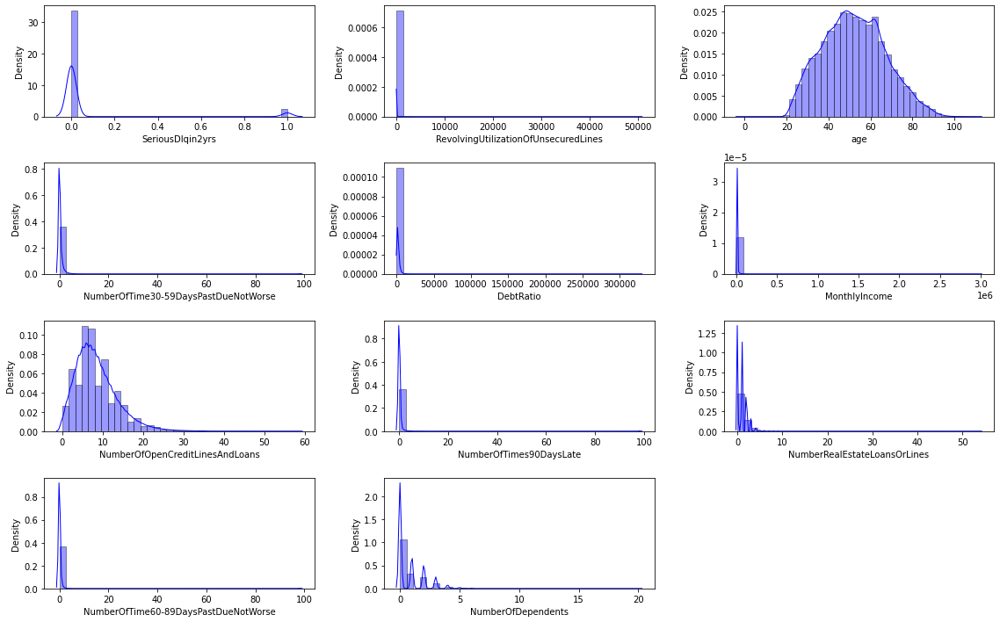

In [69]:
plt.figure(figsize=(16,12))
for i in range((len(df_train.columns))):
    ax = plt.subplot(5, 3, i+1 )
    sns.distplot(df_train[df_train.columns[i]], hist=True, kde=True, 
             bins=int(180/5), color = 'blue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 1})

plt.tight_layout()
plt.show()

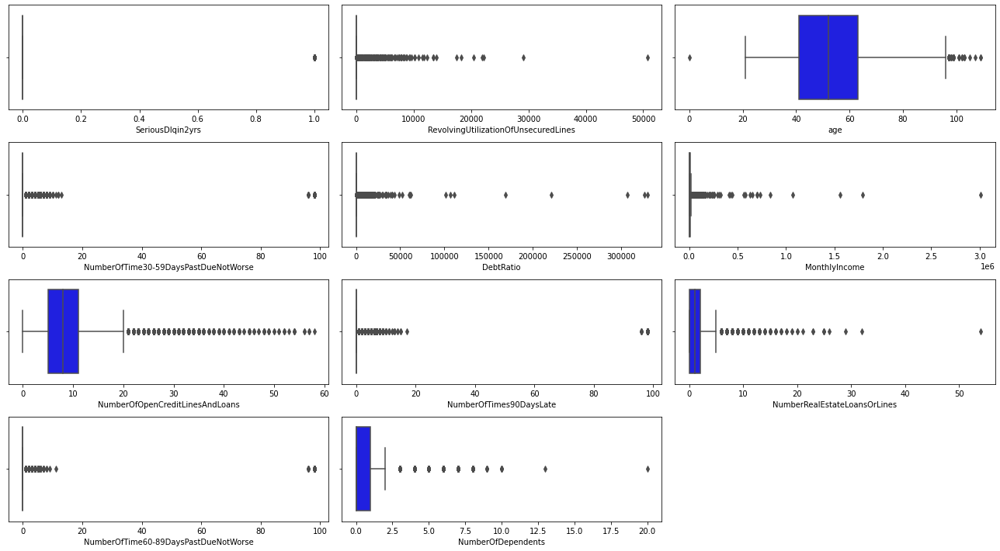

In [70]:
plt.figure(figsize=(18,12))
for i in range((len(df_train.columns))):
    ax = plt.subplot(5, 3, i+1 )
    sns.boxplot(df_train[df_train.columns[i]], color='blue')
plt.tight_layout()
plt.show()

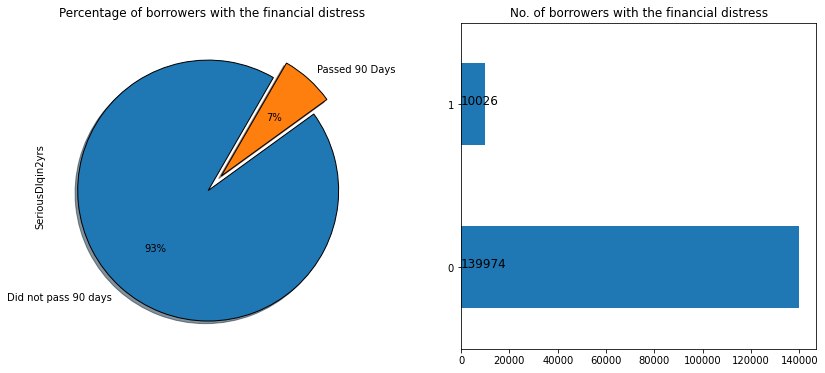

In [96]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=(14,6))

ax1 = df_train['SeriousDlqin2yrs'].value_counts().plot.pie( x="Did not pass 90 days", 
                   autopct = "%1.0f%%",labels=["Did not pass 90 days","Passed 90 Days"], startangle = 60,
                        ax=ax1,wedgeprops={"linewidth":1,"edgecolor":"k"},explode=[.05,.1],shadow =True);
ax1.set(title = 'Percentage of borrowers with the financial distress')

ax2 = df_train['SeriousDlqin2yrs'].value_counts().plot(kind="barh" ,ax =ax2)
for i,j in enumerate(df_train['SeriousDlqin2yrs'].value_counts().values):
    ax2.text(0.5,i,j,fontsize=12)
ax2.set(title = 'No. of borrowers with the financial distress')
plt.show()

## 5. Imputing Missing Values<a id='data-imp'></a>

In [97]:
((df_inputs.isna().sum()/df_inputs.shape[0]).sort_values(ascending=False))*100

MonthlyIncome                           19.820667
NumberOfDependents                       2.616000
NumberOfTime60-89DaysPastDueNotWorse     0.000000
NumberRealEstateLoansOrLines             0.000000
NumberOfTimes90DaysLate                  0.000000
NumberOfOpenCreditLinesAndLoans          0.000000
DebtRatio                                0.000000
NumberOfTime30-59DaysPastDueNotWorse     0.000000
age                                      0.000000
RevolvingUtilizationOfUnsecuredLines     0.000000
dtype: float64

In [98]:
df_inputs.NumberOfDependents.value_counts()

0.0     86902
1.0     26316
2.0     19522
3.0      9483
4.0      2862
5.0       746
6.0       158
7.0        51
8.0        24
9.0         5
10.0        5
13.0        1
20.0        1
Name: NumberOfDependents, dtype: int64

In [99]:
imputer_vals, df_inputs, imputer = fp.impute_num(df_inputs=df_inputs)
imputer_vals

,Impute value
RevolvingUtilizationOfUnsecuredLines,0.154181
age,52.000000
NumberOfTime30-59DaysPastDueNotWorse,0.000000
DebtRatio,0.366508
MonthlyIncome,5400.000000
NumberOfOpenCreditLinesAndLoans,8.000000
NumberOfTimes90DaysLate,0.000000
NumberRealEstateLoansOrLines,1.000000
NumberOfTime60-89DaysPastDueNotWorse,0.000000
NumberOfDependents,0.000000


In [100]:
df_inputs = pd.DataFrame(df_inputs, columns=input_cols)
(df_inputs.isna().sum()/df_inputs.shape[0])*100

RevolvingUtilizationOfUnsecuredLines    0.0
age                                     0.0
NumberOfTime30-59DaysPastDueNotWorse    0.0
DebtRatio                               0.0
MonthlyIncome                           0.0
NumberOfOpenCreditLinesAndLoans         0.0
NumberOfTimes90DaysLate                 0.0
NumberRealEstateLoansOrLines            0.0
NumberOfTime60-89DaysPastDueNotWorse    0.0
NumberOfDependents                      0.0
dtype: float64

In [101]:
df_inputs.shape, df_target.shape

((150000, 10), (150000,))

## 6. Training & Validation Split<a id='data-split'></a> 

In [102]:
X_train, X_val, y_train, y_val = train_test_split(df_inputs, df_target, test_size=0.20)
print(X_train.shape, X_val.shape, y_train.shape, y_val.shape)

(120000, 10) (30000, 10) (120000,) (30000,)


## 7. Handling Imbalanced Data With SMOTE<a id='data-smote'></a>

In [103]:
smt = SMOTE(random_state=42)
X_train_smote, y_train_smote = smt.fit_resample(X_train.astype('float'),y_train)
X_train.shape, y_train.shape, X_train_smote.shape, y_train_smote.shape

((120000, 10), (120000,), (223982, 10), (223982,))

In [104]:
X_train_smote

,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,0.425150,30.000000,0.000000,0.396354,3400.000000,5.000000,0.000000,1.000000,0.0,0.000000
1,0.636590,34.000000,0.000000,1.418527,3000.000000,10.000000,0.000000,2.000000,0.0,1.000000
2,1.000000,64.000000,0.000000,58.000000,5400.000000,1.000000,0.000000,0.000000,0.0,0.000000
3,0.171661,57.000000,0.000000,0.302850,10945.000000,7.000000,0.000000,1.000000,0.0,1.000000
4,0.067186,66.000000,0.000000,0.277368,10833.000000,16.000000,0.000000,2.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...
223977,1.003889,49.326313,1.000000,0.131031,12000.000000,6.673687,4.210522,1.115791,0.0,0.000000
223978,0.661203,33.844434,1.307406,0.403366,6750.000000,6.692594,0.000000,0.653703,0.0,0.000000
223979,0.625013,58.806861,0.397713,0.098453,3610.227443,3.602287,0.000000,0.000000,0.0,0.397713
223980,0.533133,47.097791,0.195582,0.586669,4290.706626,10.511044,0.000000,1.804418,0.0,1.902209


In [105]:
X_train_smote_df= pd.DataFrame(X_train_smote, columns=input_cols)
y_train_smote_df = pd.DataFrame(y_train_smote, columns=target_col)
complete_smote = pd.merge(X_train_smote_df, y_train_smote_df, left_index=True, right_index=True)
complete_smote

,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,SeriousDlqin2yrs
0,0.425150,30.000000,0.000000,0.396354,3400.000000,5.000000,0.000000,1.000000,0.0,0.000000,0
1,0.636590,34.000000,0.000000,1.418527,3000.000000,10.000000,0.000000,2.000000,0.0,1.000000,0
2,1.000000,64.000000,0.000000,58.000000,5400.000000,1.000000,0.000000,0.000000,0.0,0.000000,0
3,0.171661,57.000000,0.000000,0.302850,10945.000000,7.000000,0.000000,1.000000,0.0,1.000000,0
4,0.067186,66.000000,0.000000,0.277368,10833.000000,16.000000,0.000000,2.000000,0.0,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...
223977,1.003889,49.326313,1.000000,0.131031,12000.000000,6.673687,4.210522,1.115791,0.0,0.000000,1
223978,0.661203,33.844434,1.307406,0.403366,6750.000000,6.692594,0.000000,0.653703,0.0,0.000000,1
223979,0.625013,58.806861,0.397713,0.098453,3610.227443,3.602287,0.000000,0.000000,0.0,0.397713,1
223980,0.533133,47.097791,0.195582,0.586669,4290.706626,10.511044,0.000000,1.804418,0.0,1.902209,1


In [82]:
fig = px.scatter_3d(complete_smote, x='DebtRatio', y='MonthlyIncome', z='age',
              color='SeriousDlqin2yrs')
fig.show()

It is really tough to observe and explain the categories of class labels. Let's see how well the ML models would perform on such dataset

In [106]:
print(y_train_smote.value_counts())
print(y_train.value_counts())

1    111991
0    111991
Name: SeriousDlqin2yrs, dtype: int64
0    111991
1      8009
Name: SeriousDlqin2yrs, dtype: int64


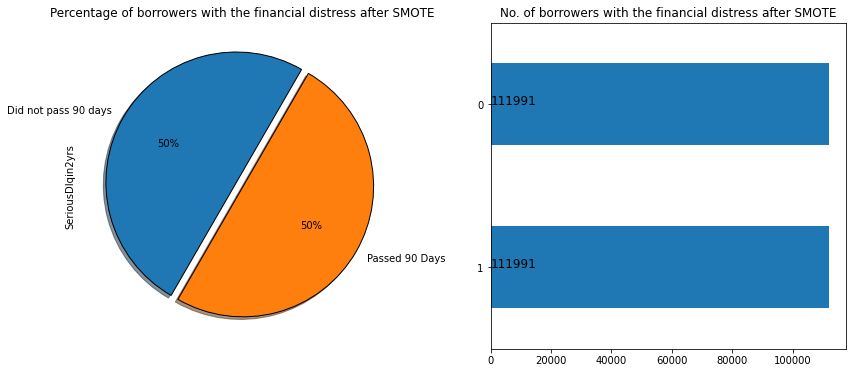

In [107]:
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=(14,6))

ax1 = y_train_smote.value_counts().plot.pie( x="Did not pass 90 days", 
                   autopct = "%1.0f%%",labels=["Did not pass 90 days","Passed 90 Days"], startangle = 60,
                        ax=ax1,wedgeprops={"linewidth":1,"edgecolor":"k"},explode=[.05,.01],shadow =True);
ax1.set(title = 'Percentage of borrowers with the financial distress after SMOTE')

ax2 = y_train_smote.value_counts().plot(kind="barh" ,ax =ax2)
for i,j in enumerate(y_train_smote.value_counts().values):
    ax2.text(0.5,i,j,fontsize=12)
ax2.set(title = 'No. of borrowers with the financial distress after SMOTE')
plt.show()

## 8. Scaling Numeric Feature<a id='data-scaling'></a>

In [108]:
X_train_smote, scaler = fp.num_scaler(df=X_train_smote)
X_val, val_scaler = fp.num_scaler(df=X_val)
scaler.data_min_, scaler.data_max_

(array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
 array([5.07080e+04, 1.09000e+02, 9.80000e+01, 3.29664e+05, 3.00875e+06,
        5.80000e+01, 9.80000e+01, 5.40000e+01, 9.80000e+01, 2.00000e+01]))

## 9. Building and Experimenting with base models<a id='base-models'></a>

In [109]:
models = {
          'log_reg': LogisticRegression(C= 1300, penalty = 'l2'),
          'knn' : KNeighborsClassifier(),
          'AdaBoost' : AdaBoostClassifier(),
          'DecTree': DecisionTreeClassifier(),
          'GaussianNB' : GaussianNB(),
          'SGD' : SGDClassifier()
         }

In [110]:
fp.compare_models(models=models, X_train = X_train_smote, y_train = y_train_smote, X_val=X_val , y_val=y_val )

,log_reg,knn,AdaBoost,DecTree,GaussianNB,SGD
Training Accuracy,[0.7496852425641346],[0.91927029850613],[0.924739487994571],[0.9998124849318248],[0.5141975694475449],[0.6630711396451501]
Val Accuracy,[0.5950666666666666],[0.7968666666666666],[0.9076333333333333],[0.5498],[0.9311666666666667],[0.4217]
Precision,[0.11967865455364517],[0.13157419121633834],[0.3448559670781893],[0.06902243229049441],[0.3878504672897196],[0.09236413910454111]
Recall,[0.7902825979176995],[0.360932077342588],[0.4154685176003966],[0.4561229548834903],[0.04115022310361924],[0.8611799702528508]
ROC,[0.6856391011959222],[0.5946103405688747],[0.6792884166817692],[0.5063375736430101],[0.5182344046940746],[0.625601241960932]
F1 Score,[0.20787689097548254],[0.1928476821192053],[0.3768832921070384],[0.11990095138798383],[0.07440609592111161],[0.1668347500360179]


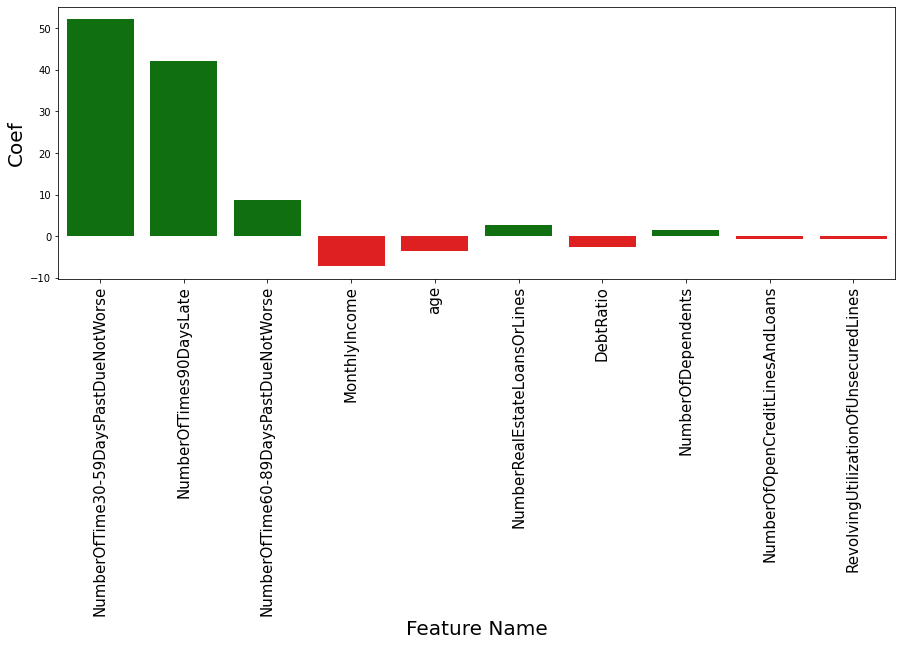

In [112]:
log_reg_model = LogisticRegression()
log_reg_model.fit(X_train_smote, y_train_smote)
weights = log_reg_model.coef_
weights = np.array(weights).flatten()
weights_df = pd.DataFrame({
    'columns': X_train.columns,
    'weight': weights
}).sort_values('weight', ascending=False)
weights_df["abs_value"] = weights_df["weight"].apply(lambda x: abs(x))
weights_df["colors"] = weights_df["weight"].apply(lambda x: "green" if x > 0 else "red")
weights_df = weights_df.sort_values("abs_value", ascending=False)

fig, ax = plt.subplots(1, 1, figsize=(15, 5))
sns.barplot(x="columns",
            y="weight",
            data=weights_df.head(30),
           palette=weights_df.head(30)["colors"])
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=15)
ax.set_ylabel("Coef", fontsize=20)
ax.set_xlabel("Feature Name", fontsize=20);

In [311]:
%%time
models = {
          'log_reg': LogisticRegression(C= 1300, penalty = 'l2'),
          'knn' : KNeighborsClassifier(n_neighbors = 1, weights = 'uniform'),
          'SVC' : SVC()
          'AdaBoost' : AdaBoostClassifier(),
          'DecTree': DecisionTreeClassifier(),
          'GaussianNB' : GaussianNB(),
          'SGD' : SGDClassifier()
         }

fp.compare_models(models=models, X_train = X_train_smote, y_train = y_train_smote, X_val=X_val , y_val=y_val )

Wall time: 11h 16min 47s


,log_reg,knn,SVC,AdaBoost,DecTree,GaussianNB,SGD
Training Accuracy,[0.747322489303356],[0.9997230931389626],[0.7318246375646488],[0.9235737063536726],[0.9997543568168217],[0.5254129038597244],[0.6602263490276996]
Val Accuracy,[0.9058333333333334],[0.8127333333333333],[0.9142],[0.9095],[0.4493333333333333],[0.9302333333333334],[0.8177666666666666]
Precision,[0.3247933884297521],[0.1356814088453072],[0.36326156665139714],[0.3370141342756184],[0.06377107204991302],[0.3231707317073171],[0.1618217054263566]
Recall,[0.3975720789074355],[0.34294385432473445],[0.4011127971674254],[0.3859382903388973],[0.537683358624178],[0.05361659079413252],[0.4223571067273647]
ROC,[0.6696314164654581],[0.5944102278439503],[0.6757553423085101],[0.6661875728895357],[0.49039183454172175],[0.5228472633876454],[0.6340097991260917]
F1 Score,[0.35751648851489654],[0.19443647834815028],[0.3812499999999999],[0.3598207969818439],[0.11401909256677036],[0.09197396963123644],[0.23399187333613566]


The focused evaluation metric for this use case is **Recall** and **F1 Score** but I was not able to get the significant improvement even after SMOTE so I went for running the GridSearchCV for finding the best class weights for each of the model.

In [ ]:
%%time 
logistic_params ={"C":[1200,1300, 1350, 1400, 1450, 1500], "penalty":["l1","l2"]}
logreg=LogisticRegression()
stratified_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)
logreg_cv=GridSearchCV(logreg,grid,cv= stratified_kfold, verbose=2)
logistic_reg = logreg_cv.fit(X_train_smote,y_train_smote)
print(f"Best Parameters for logistic reg : {logistic_reg.best_params_} Score {logistic_reg.best_score_}" )

k_range = list(range(1,31))
weight_options = ["uniform", "distance"]
param_grid = dict(n_neighbors = k_range, weights = weight_options)
knn = KNeighborsClassifier()
knn_cv = GridSearchCV(knn, param_grid, cv = stratified_kfold, scoring = 'accuracy')
model_knn  = knn_cv.fit(X_train_smote,y_train_smote)
print(f"Best Parameters for knn : {model_knn.best_params_} Score {model_knn.best_score_}" )


models = {'logistic' :logistic_reg.best_estimator_, 'knn':model_knn.best_estimator_}

### a ) - Finding Best Class Weights for Each Algorithm<a id='class-weights'></a>

Fitting 3 folds for each of 20 candidates, totalling 60 fits
[CV] END ....................class_weight={0: 0.05, 1: 0.95}; total time=  10.7s
[CV] END ....................class_weight={0: 0.05, 1: 0.95}; total time=  11.0s
[CV] END ....................class_weight={0: 0.05, 1: 0.95}; total time=  11.0s
[CV] END class_weight={0: 0.09736842105263158, 1: 0.9026315789473685}; total time=  11.8s
[CV] END class_weight={0: 0.09736842105263158, 1: 0.9026315789473685}; total time=  12.5s
[CV] END class_weight={0: 0.09736842105263158, 1: 0.9026315789473685}; total time=  11.3s
[CV] END class_weight={0: 0.14473684210526316, 1: 0.8552631578947368}; total time=  11.7s
[CV] END class_weight={0: 0.14473684210526316, 1: 0.8552631578947368}; total time=  12.0s
[CV] END class_weight={0: 0.14473684210526316, 1: 0.8552631578947368}; total time=  11.4s
[CV] END class_weight={0: 0.19210526315789472, 1: 0.8078947368421052}; total time=  11.7s
[CV] END class_weight={0: 0.19210526315789472, 1: 0.80789473684210

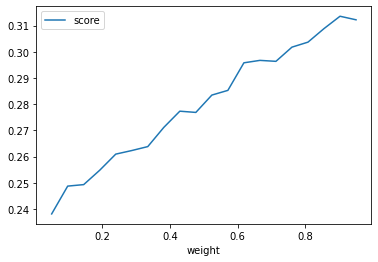

In [88]:
fp.best_weights(model=RandomForestClassifier(), X_train=X_train, y_train=y_train)

### b ) - Training and Evaluating Models on New Weights<a id='train-weights'></a> 

In [113]:
%%time
models = {
        'log_reg': LogisticRegression(C= 1300, penalty = 'l2', class_weight = {0: 0.09736842105263158, 1: 0.9026315789473685}),
        'DecTree': DecisionTreeClassifier( class_weight = {0: 0.618421052631579, 1: 0.381578947368421}),
        'SGD' : SGDClassifier( class_weight = {0: 0.05, 1: 0.95}),
        'lgb':lgb.LGBMClassifier( class_weight = {0: 0.19210526315789472, 1: 0.8078947368421052}),
        'rnd_forest': RandomForestClassifier(class_weight =  {0: 0.8552631578947368, 1: 0.14473684210526316}),
        'ex_tree': ExtraTreesClassifier(class_weight = {0: 0.95, 1: 0.050000000000000044}),

         }

fp.compare_models(models=models, X_train = X_train, y_train = y_train, X_val=X_val , y_val=y_val )

Wall time: 1min 13s


,log_reg,DecTree,SGD,lgb,rnd_forest,ex_tree
Training Accuracy,[0.9136416666666667],[0.9996916666666666],[0.9326666666666666],[0.9177833333333333],[0.9996416666666667],[0.999675]
Val Accuracy,[0.06723333333333334],[0.9231666666666667],[0.06723333333333334],[0.9342333333333334],[0.9330333333333334],[0.9327666666666666]
Precision,[0.06723333333333334],[0.14],[0.06723333333333334],[0.5528846153846154],[0.5625],[0.0]
Recall,[1.0],[0.027764005949429845],[1.0],[0.11403073872087258],[0.017848289538919187],[0.0]
ROC,[0.5],[0.5077354139742504],[0.5],[0.5536919229822781],[0.5084238410136078],[0.5]
F1 Score,[0.12599556485617017],[0.046338436077782375],[0.12599556485617017],[0.1890669954788327],[0.03459875060067275],[0.0]


Models with the tunned weights could not perform upto the mark. As the f1 score for almost all the models is quit low.Moving on, I am going to continue with SMOTE instead of going for the weighted class labels

In [114]:
#Trying out Multi-layer perceptron from SKlearn
mlp = MLPClassifier()
mlp.fit(X_train_smote, y_train_smote)
y_predicted =  mlp.predict(X_val)
y_predicted_train =  mlp.predict(X_train)
acc_train = []
acc_val = []
recall = []
f1 = []
acc_train.append(accuracy_score(y_train, y_predicted_train))
acc_val.append(accuracy_score(y_val,y_predicted))
recall.append(recall_score(y_val, y_predicted))
f1.append(f1_score(y_val, y_predicted))
results = [acc_train, acc_val, recall, f1]
df =  pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'recall', 'f1'])
df

,0
Training Accuracy,0.933258
Val Accuracy,0.855600
recall,0.536440
f1,0.333128


In [147]:
#Trying out Multi-layer perceptron from SKlearn
mlp = MLPClassifier( activation = 'relu', alpha = 0.0001, hidden_layer_sizes = (50, 100, 50), learning_rate = 'adaptive')
mlp.fit(X_train_smote, y_train_smote)
y_predicted =  mlp.predict(X_val)
y_predicted_train =  mlp.predict(X_train)
acc_train = []
acc_val = []
recall = []
f1 = []
acc_train.append(accuracy_score(y_train, y_predicted_train))
acc_val.append(accuracy_score(y_val,y_predicted))
recall.append(recall_score(y_val, y_predicted))
f1.append(f1_score(y_val, y_predicted))
results = [acc_train, acc_val, recall, f1]
df =  pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'recall', 'f1'])
df

,0
Training Accuracy,0.933375
Val Accuracy,0.853000
recall,0.430044
f1,0.284323


I could get the f1 score as **0.284323** which comparitively is better than the rest of the models I have tried above

## 10. Model evaluation & Hyperparameter tuning<a id='eval-tuning'></a>

This is the list of final models after experimentation. Here, I have made the fianl comparison and on the basis of this comparision I selected the best model for further hyperparameter tuning

In [98]:
final_models = {
          'log_reg': LogisticRegression(),
          'AdaBoost' : AdaBoostClassifier(),
          'rand_f': RandomForestClassifier(),
          'xgb' : XGBClassifier(),
          'lgb' : lgb.LGBMClassifier(),
          'SGD' : SGDClassifier(),
          'mlp' : MLPClassifier()
         }
fp.compare_models(models=final_models, X_train = X_train_smote, y_train = y_train_smote, X_val=X_val , y_val=y_val )

[14:05:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:05:25] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


,log_reg,AdaBoost,rand_f,xgb,lgb,SGD,mlp
Training Accuracy,[0.7305986003499125],[0.9272369407648088],[0.9992457242832149],[0.9685525047309601],[0.9622549719712928],[0.6632181240404185],[0.8676268432891777]
Val Accuracy,[0.5691333333333334],[0.6449],[0.5381333333333334],[0.22806666666666667],[0.32963333333333333],[0.44003333333333333],[0.7035]
Precision,[0.11446808510638298],[0.1206211947410218],[0.07964097449779171],[0.07533805537669028],[0.08353706351768993],[0.0949398384704137],[0.14209479962331276]
Recall,[0.7857838364167478],[0.6655306718597858],[0.5443037974683544],[0.9113924050632911],[0.8816942551119766],[0.8412852969814996],[0.6611489776046738]
ROC,[0.669496799049997],[0.6544571701816642],[0.5409918042662748],[0.5446176939794377],[0.5853758615429632],[0.6259135280441742],[0.6838808653857478]
F1 Score,[0.1998266683174446],[0.20422798237095688],[0.13895103156848124],[0.13917180878745075],[0.15261450301268276],[0.17062453715132064],[0.23391611402979934]


As MLP has been performing comparitivey better than other other models, I am going to tune the hyperparameters for improved performance

In [28]:
%%time 
mlp =MLPClassifier(max_iter=100)
f1 = make_scorer(f1_score , average='macro')
param_grid = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['relu'],
    'alpha': [0.0001],
    'learning_rate': ['adaptive'],
}
CV_mlp = GridSearchCV(estimator=mlp, param_grid=param_grid, cv= 5, verbose=2, scoring=f1)
model_mlp = CV_mlp.fit(X_train_smote, y_train_smote)
print(f"Best Parameters : {model_mlp.best_params_} Best accuracy of {model_mlp.best_score_}" )

Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV] END activation=relu, alpha=0.0001, hidden_layer_sizes=(50, 50, 50), learning_rate=adaptive; total time= 4.2min
[CV] END activation=relu, alpha=0.0001, hidden_layer_sizes=(50, 50, 50), learning_rate=adaptive; total time= 3.6min
[CV] END activation=relu, alpha=0.0001, hidden_layer_sizes=(50, 50, 50), learning_rate=adaptive; total time= 4.3min
[CV] END activation=relu, alpha=0.0001, hidden_layer_sizes=(50, 50, 50), learning_rate=adaptive; total time= 4.1min
[CV] END activation=relu, alpha=0.0001, hidden_layer_sizes=(50, 50, 50), learning_rate=adaptive; total time= 3.8min
[CV] END activation=relu, alpha=0.0001, hidden_layer_sizes=(50, 100, 50), learning_rate=adaptive; total time= 6.4min
[CV] END activation=relu, alpha=0.0001, hidden_layer_sizes=(50, 100, 50), learning_rate=adaptive; total time= 6.7min
[CV] END activation=relu, alpha=0.0001, hidden_layer_sizes=(50, 100, 50), learning_rate=adaptive; total time= 6.8min
[CV] END 

**LGBM Hyperparameter tuning** :It was taking too long to experiment with the complete grid at once so I picked selective params every time, checked their effect and droped the once which were not making significant differece in F1 Score

In [91]:
'''
base_grid_lgbm = {
    'n_estimators': [400, 700, 1000],
    'colsample_bytree': [0.7, 0.8],
    'max_depth': [15,20,25],
    'num_leaves': [50, 100, 200],
    'reg_alpha': [1.1, 1.2, 1.3],
   'reg_lambda': [1.1, 1.2, 1.3],
    'min_split_gain': [0.3, 0.4],
    'subsample': [0.7, 0.8, 0.9],
    'subsample_freq': [20]
}
'''
lgbm =lgb.LGBMClassifier()
f1 = make_scorer(f1_score , average='macro')
param_grid = {
    'n_estimators': [150],
    'colsample_bytree': [0.5,0.7, 0.8],
    'max_depth': [8],
    'num_leaves': [50]
 
}
CV_lgbm = GridSearchCV(estimator=lgbm, param_grid=param_grid, cv= 5, verbose=2, scoring = f1_score)
model_lgmb = CV_lgbm.fit(X_train_smote, y_train_smote)
print(f"Best Parameters : {model_lgmb.best_params_} ----- Best Score : {model_lgmb.best_score_}" )

Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV] END colsample_bytree=0.5, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.8s
[CV] END colsample_bytree=0.5, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.8s
[CV] END colsample_bytree=0.5, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.8s
[CV] END colsample_bytree=0.5, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.8s
[CV] END colsample_bytree=0.5, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.8s
[CV] END colsample_bytree=0.7, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.7s
[CV] END colsample_bytree=0.7, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.7s
[CV] END colsample_bytree=0.7, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.8s
[CV] END colsample_bytree=0.7, max_depth=8, n_estimators=150, num_leaves=50; total time=   0.8s
[CV] END colsample_bytree=0.7, max_depth=8, n_estimators=150, num_leaves=50;

In [32]:
class_weight = {0: 0.001, 1: 1.1}
model = lgb.LGBMClassifier( class_weight=class_weight, max_depth = 15,  n_estimators = 400)
model.fit(X_train, y_train)
y_predicted =  model.predict(X_val)
y_predicted_train =  model.predict(X_train)
acc_train = []
acc_val = []
recall = []
f1 = []
prc = []
acc_train.append(accuracy_score(y_train, y_predicted_train))
acc_val.append(accuracy_score(y_val,y_predicted))
prc.append(precision_score(y_val, y_predicted))
recall.append(recall_score(y_val, y_predicted))
f1.append(f1_score(y_val, y_predicted))
results = [acc_train, acc_val, prc, recall, f1]
df =  pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'Precision','recall', 'f1'])
df

,0
Training Accuracy,0.492908
Val Accuracy,0.920467
Precision,0.388658
recall,0.381512
f1,0.385052


In [26]:
class_weight = {0: 0.001, 1: 1.1}
model = lgb.LGBMClassifier( class_weight=class_weight)
model.fit(X_train, y_train)
y_predicted =  model.predict(X_val)
y_predicted_train =  model.predict(X_train)
acc_train = []
acc_val = []
recall = []
f1 = []
prc = []
acc_train.append(accuracy_score(y_train, y_predicted_train))
acc_val.append(accuracy_score(y_val,y_predicted))
prc.append(precision_score(y_val, y_predicted))
recall.append(recall_score(y_val, y_predicted))
f1.append(f1_score(y_val, y_predicted))
results = [acc_train, acc_val, prc, recall, f1]
df =  pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'Precision','recall', 'f1'])
df

,0
Training Accuracy,0.322858
Val Accuracy,0.861633
Precision,0.230656
recall,0.479571
f1,0.311494


In [36]:
model = lgb.LGBMClassifier( max_depth = 15,  n_estimators = 400)
model.fit(X_train_smote, y_train_smote)
y_predicted =  model.predict(X_val)
y_predicted_train =  model.predict(X_train)
acc_train = []
acc_val = []
recall = []
f1 = []
prc = []
acc_train.append(accuracy_score(y_train, y_predicted_train))
acc_val.append(accuracy_score(y_val,y_predicted))
prc.append(precision_score(y_val, y_predicted))
recall.append(recall_score(y_val, y_predicted))
f1.append(f1_score(y_val, y_predicted))
results = [acc_train, acc_val, prc, recall, f1]
df =  pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'Precision','recall', 'f1'])
df

,0
Training Accuracy,0.929558
Val Accuracy,0.261767
Precision,0.072140
recall,0.869254
f1,0.133224


In [39]:
class_weight = {0: 0.001, 1: 1.1}
model = lgb.LGBMClassifier( class_weight=class_weight, max_depth = 10,  n_estimators = 200)
model.fit(X_train, y_train)
y_predicted =  model.predict(X_val)
y_predicted_train =  model.predict(X_train)
acc_train = []
acc_val = []
recall = []
f1 = []
prc = []
acc_train.append(accuracy_score(y_train, y_predicted_train))
acc_val.append(accuracy_score(y_val,y_predicted))
prc.append(precision_score(y_val, y_predicted))
recall.append(recall_score(y_val, y_predicted))
f1.append(f1_score(y_val, y_predicted))
results = [acc_train, acc_val, prc, recall, f1]
df =  pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'Precision','recall', 'f1'])
df

,0
Training Accuracy,0.353700
Val Accuracy,0.917033
Precision,0.373027
recall,0.398366
f1,0.385280


In [42]:
class_weight = {0: 0.001, 1: 1.1}
model = lgb.LGBMClassifier( class_weight=class_weight, max_depth = 8,  n_estimators = 150)
model.fit(X_train, y_train)
y_predicted =  model.predict(X_val)
y_predicted_train =  model.predict(X_train)
acc_train = []
acc_val = []
recall = []
f1 = []
prc = []
acc_train.append(accuracy_score(y_train, y_predicted_train))
acc_val.append(accuracy_score(y_val,y_predicted))
prc.append(precision_score(y_val, y_predicted))
recall.append(recall_score(y_val, y_predicted))
f1.append(f1_score(y_val, y_predicted))
results = [acc_train, acc_val, prc, recall, f1]
df =  pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'Precision','recall', 'f1'])
df

,0
Training Accuracy,0.272592
Val Accuracy,0.922100
Precision,0.398063
recall,0.377937
f1,0.387739


In [70]:
class_weight = {0: 0.001, 1: 1.1}
model = lgb.LGBMClassifier( class_weight=class_weight, max_depth = 8,  n_estimators = 150, num_leaves=50)
model.fit(X_train, y_train)
y_predicted =  model.predict(X_val)
y_predicted_train =  model.predict(X_train)
acc_train = []
acc_val = []
recall = []
f1 = []
prc = []
acc_train.append(accuracy_score(y_train, y_predicted_train))
acc_val.append(accuracy_score(y_val,y_predicted))
prc.append(precision_score(y_val, y_predicted))
recall.append(recall_score(y_val, y_predicted))
f1.append(f1_score(y_val, y_predicted))
results = [acc_train, acc_val, prc, recall, f1]
df =  pd.DataFrame(results, index=['Training Accuracy','Val Accuracy', 'Precision','recall', 'f1'])
df

,0
Training Accuracy,0.330942
Val Accuracy,0.919567
Precision,0.392435
recall,0.423902
f1,0.407562


In [156]:
model = lgb.LGBMClassifier( class_weight= {0: 0.001, 1: 1.1}, max_depth = 8,  n_estimators = 170, num_leaves=60)
model.fit(X_train, y_train)
y_predicted =  model.predict(X_val)
y_predicted_train =  model.predict(X_train)
print(classification_report(y_val, y_predicted))

So, I have imporoved the F1 Score form **0.13** to **0.41** by assigning the class weights and performing the hyperparameter tuning

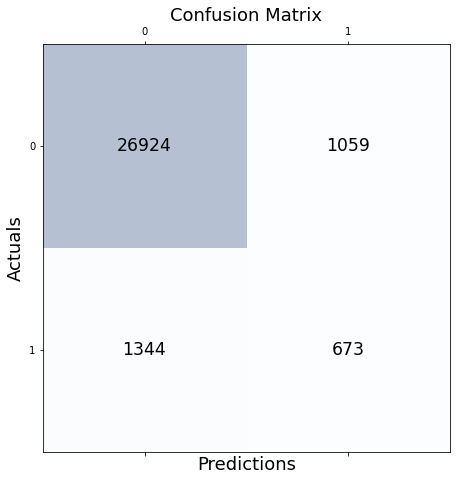

In [157]:
fp.draw_cm(y_val=y_val, y_predicted=y_predicted)

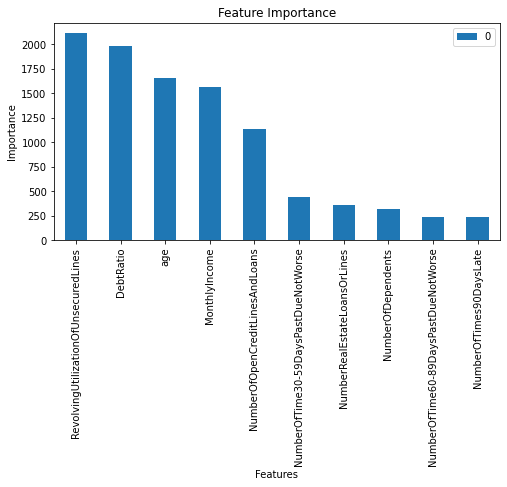

In [155]:
ax = pd.DataFrame(model.feature_importances_.tolist(), df_inputs.columns).sort_values(ascending=False, by=0)\
                 .plot(kind='bar', title= "Feature Importance",figsize= (8,4))
ax.set_xlabel("Features")
ax.set_ylabel("Importance");

## 11. Training the Model on Complete Dataset<a id='train-complete'></a>

In [158]:
df_inputs.shape, df_target.shape

((150000, 10), (150000,))

In [159]:
df_inputs, scaler_final = fp.num_scaler(df=df_inputs)
scaler_final.data_min_, scaler_final.data_max_

(array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
 array([5.07080e+04, 1.09000e+02, 9.80000e+01, 3.29664e+05, 3.00875e+06,
        5.80000e+01, 9.80000e+01, 5.40000e+01, 9.80000e+01, 2.00000e+01]))

In [160]:
df_test = df_test.drop(['SeriousDlqin2yrs'], axis = 1)

In [161]:
lgbm_final = lgb.LGBMClassifier( class_weight= {0: 0.001, 1: 1.1}, max_depth = 8,  n_estimators = 170, num_leaves=60)
lgbm_final.fit(df_inputs, df_target)
LGBM = {
    'model': lgbm_final,
    'imputer': imputer,
    'scaler': scaler_final,
    'input_cols' : input_cols,
    'target_col' : target_col
}
joblib.dump( LGBM , 'lgbm_give_me_credit.joblib')

['lgbm_give_me_credit.joblib']

In [162]:
df_test.shape, df_sample.shape

((101503, 10), (101503, 2))

## 12. Prediction on Test File and Submission to the competition<a id='test-submit'></a>

In [164]:
gbm = joblib.load('lgbm_give_me_credit.joblib')
df_test = gbm['imputer'].transform(df_test)
df_test = gbm['scaler'].transform(df_test)
prob = gbm['model'].predict_proba(df_test)[:,0]

In [253]:
df_sample['Probability'] = prob
df_sample

,Id,Probability
0,1,0.121986
1,2,0.023873
2,3,0.069461
3,4,0.018777
4,5,0.008967
...,...,...
101498,101499,0.028091
101499,101500,0.002967
101500,101501,0.813181
101501,101502,0.981370


In [259]:
from IPython.display import FileLink
submission_df = df_sample
submission_df.to_csv('submission.csv', index=None)
FileLink('submission.csv')

D:\BLUEHORIZON_DATA\Production\Hasnain\models\final_projects\Give me credit\submission.csv

## 13. Conclusion<a id='project-conclusion'></a>

A highly imbalanced dataset was used for the purpose of making the binary classification. The class of interest had only **7%** data available. 
In the stated snario, F1 Score was selected as metrics for evaluation. Both Smote and class weights were tried out with multiple models.
Maximum F1 Score of **0.41** was achived after running a lot of experiments with both of the above stated techniques to handle the imbalanced data.

*Copyright &copy; 2021 Hasanain*